# Youtube Sentiment Data Analysis Project


### Importing necessary libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
us_comments = pd.read_csv('UScomments.csv',error_bad_lines=False)
us_comments.head()

C:\Users\USER\AppData\Local\Temp\ipykernel_13956\1160877986.py:1: FutureWarning: The error_bad_lines argument has been deprecated and will be removed in a future version. Use on_bad_lines in the future.


  us_comments = pd.read_csv('UScomments.csv',error_bad_lines=False)
b'Skipping line 41589: expected 4 fields, saw 11\nSkipping line 51628: expected 4 fields, saw 7\nSkipping line 114465: expected 4 fields, saw 5\n'
b'Skipping line 142496: expected 4 fields, saw 8\nSkipping line 189732: expected 4 fields, saw 6\nSkipping line 245218: expected 4 fields, saw 7\n'
b'Skipping line 388430: expected 4 fields, saw 5\n'
C:\Users\USER\AppData\Local\Temp\ipykernel_13956\1160877986.py:1: DtypeWarning: Columns (2,3) have mixed types. Specify dtype option on import or set low_memory=False.
  us_comments = pd.read_csv('UScomments.csv',error_bad_lines=False)


,video_id,comment_text,likes,replies
0,XpVt6Z1Gjjo,Logan Paul it's yo big day ‼️‼️‼️,4,0
1,XpVt6Z1Gjjo,I've been following you from the start of your...,3,0
2,XpVt6Z1Gjjo,Say hi to Kong and maverick for me,3,0
3,XpVt6Z1Gjjo,MY FAN . attendance,3,0
4,XpVt6Z1Gjjo,trending 😉,3,0


In [3]:
us_comments.isnull().sum()

video_id         0
comment_text    25
likes            0
replies          0
dtype: int64

## 1. Performing Sentiment Analysis:

### Performing Sentiment Analysis for a single comment

In [4]:
# !pip install textblob

In [5]:
from textblob import TextBlob

In [6]:
TextBlob("Logan Paul it's yo big day ‼️‼️‼️").sentiment.polarity # neutral sentence

0.0

**Polarity ranges from -1 to +1**

    -1 -> negative sentence

    +1 -> positive sentence

    0  -> neutral sentence

### Performing Sentiment Analysis on all Comments:

In [7]:
polarity = []
for i in us_comments['comment_text']:
    try:
        polarity.append(TextBlob(i).sentiment.polarity)
    except:
        polarity.append(0)

In [8]:
us_comments['polarity'] = polarity

In [9]:
us_comments.head()

,video_id,comment_text,likes,replies,polarity
0,XpVt6Z1Gjjo,Logan Paul it's yo big day ‼️‼️‼️,4,0,0.0
1,XpVt6Z1Gjjo,I've been following you from the start of your...,3,0,0.0
2,XpVt6Z1Gjjo,Say hi to Kong and maverick for me,3,0,0.0
3,XpVt6Z1Gjjo,MY FAN . attendance,3,0,0.0
4,XpVt6Z1Gjjo,trending 😉,3,0,0.0


### Performing EDA for positive comments:

In [10]:
comments_positive = us_comments[us_comments['polarity'] == 1]
comments_positive.head()

,video_id,comment_text,likes,replies,polarity
64,XpVt6Z1Gjjo,yu are the best,1,0,1.0
156,cLdxuaxaQwc,Power is the disease. Care is the cure. Keep...,0,0,1.0
227,WYYvHb03Eog,YAS Can't wait to get it! I just need to sell ...,0,0,1.0
307,sjlHnJvXdQs,This is priceless,0,0,1.0
319,sjlHnJvXdQs,Summed up perfectly,0,0,1.0


In [11]:
comments_positive.shape

(19390, 5)

In [12]:
from wordcloud import WordCloud, STOPWORDS

In [13]:
total_positive_comments = " ".join(comments_positive['comment_text'])

In [14]:
len(total_positive_comments)

846560

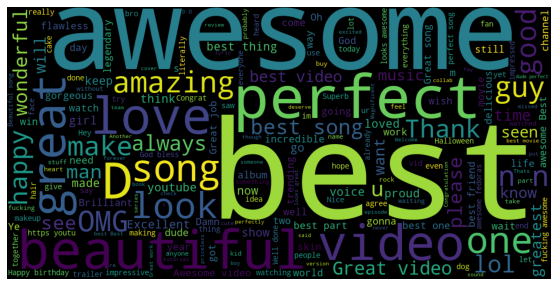

In [15]:
# finding the most common words when the comment is positive
wordcloud = WordCloud(width = 1000, height= 500, stopwords=set(STOPWORDS)).generate(total_positive_comments)
plt.figure(figsize=(15,5))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

In [16]:
# bigger the word, higher the word is repeated

### Performing EDA for negative comments:

In [17]:
comments_negative = us_comments[us_comments['polarity'] == -1]
comments_negative.head()

,video_id,comment_text,likes,replies,polarity
512,8wNr-NQImFg,BEN CARSON IS THE MAN!!!!! THEY HATE HIM CAUSE...,0,0,-1.0
562,8wNr-NQImFg,Well… The brain surgeon Ben Carson just proved...,0,0,-1.0
952,Ayb_2qbZHm4,WHY DID YOU MAKE FURRY FORCE?! SO NASTY!!!,0,0,-1.0
1371,vu_9muoxT50,WTF BRUH!!!!!!,0,0,-1.0
1391,vu_9muoxT50,cheeseus christ thats insane!!!,0,0,-1.0


In [18]:
total_negative_comments = " ".join(comments_negative['comment_text'])

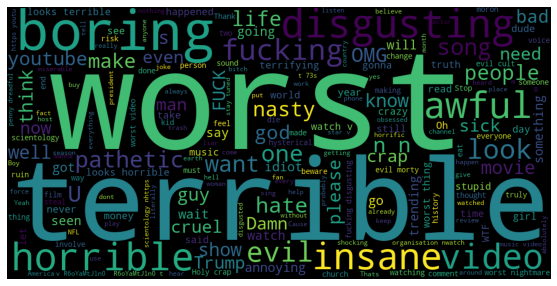

In [19]:
# finding the most common words when the comment is negative
wordcloud = WordCloud(width = 1000, height= 500, stopwords=set(STOPWORDS)).generate(total_negative_comments)
plt.figure(figsize=(15,5))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

## 2. Analysing Trending Tags and Views on Youtube

In [20]:
us_videos = pd.read_csv('USvideos.csv')
us_videos.head()

,video_id,trending_date,title,channel_title,category_id,publish_time,tags,views,likes,dislikes,comment_count,thumbnail_link,comments_disabled,ratings_disabled,video_error_or_removed,description
0,2kyS6SvSYSE,17.14.11,WE WANT TO TALK ABOUT OUR MARRIAGE,CaseyNeistat,22,2017-11-13T17:13:01.000Z,SHANtell martin,748374,57527,2966,15954,https://i.ytimg.com/vi/2kyS6SvSYSE/default.jpg,False,False,False,SHANTELL'S CHANNEL - https://www.youtube.com/s...
1,1ZAPwfrtAFY,17.14.11,The Trump Presidency: Last Week Tonight with J...,LastWeekTonight,24,2017-11-13T07:30:00.000Z,"last week tonight trump presidency|""last week ...",2418783,97185,6146,12703,https://i.ytimg.com/vi/1ZAPwfrtAFY/default.jpg,False,False,False,"One year after the presidential election, John..."
2,5qpjK5DgCt4,17.14.11,"Racist Superman | Rudy Mancuso, King Bach & Le...",Rudy Mancuso,23,2017-11-12T19:05:24.000Z,"racist superman|""rudy""|""mancuso""|""king""|""bach""...",3191434,146033,5339,8181,https://i.ytimg.com/vi/5qpjK5DgCt4/default.jpg,False,False,False,WATCH MY PREVIOUS VIDEO ▶ \n\nSUBSCRIBE ► http...
3,puqaWrEC7tY,17.14.11,Nickelback Lyrics: Real or Fake?,Good Mythical Morning,24,2017-11-13T11:00:04.000Z,"rhett and link|""gmm""|""good mythical morning""|""...",343168,10172,666,2146,https://i.ytimg.com/vi/puqaWrEC7tY/default.jpg,False,False,False,Today we find out if Link is a Nickelback amat...
4,d380meD0W0M,17.14.11,I Dare You: GOING BALD!?,nigahiga,24,2017-11-12T18:01:41.000Z,"ryan|""higa""|""higatv""|""nigahiga""|""i dare you""|""...",2095731,132235,1989,17518,https://i.ytimg.com/vi/d380meD0W0M/default.jpg,False,False,False,I know it's been a while since we did this sho...


In [21]:
total_tags = " ".join(us_videos['tags'])

In [22]:
import re # re = regular expression
# re is used when we have to find any pattern in text data

In [23]:
total_tags = re.sub('[^a-zA-Z]',' ',total_tags)
# sub represents substitute function
# meaning of the above expression is that accept all charachers from a-z,A-Z and replace the remainig charachers with space(' ')
total_tags

'SHANtell martin last week tonight trump presidency  last week tonight donald trump   john oliver trump   donald trump  racist superman  rudy   mancuso   king   bach   racist   superman   love   rudy mancuso poo bear black white official music video   iphone x by pineapple   lelepons   hannahstocking   rudymancuso   inanna   anwar   sarkis   shots   shotsstudios   alesso   anitta   brazil   Getting My Driver s License   Lele Pons  rhett and link  gmm   good mythical morning   rhett and link good mythical morning   good mythical morning rhett and link   mythical morning   Season      nickelback lyrics   nickelback lyrics real or fake   nickelback   nickelback songs   nickelback song   rhett link nickelback   gmm nickelback   lyrics  website category    nickelback  musical group    rock   music   lyrics   chad kroeger   canada   music  industry    mythical   gmm challenge   comedy   funny   challenge  ryan  higa   higatv   nigahiga   i dare you   idy   rhpc   dares   no truth   comments 

In [24]:
total_tags = re.sub(' +',' ',total_tags)
# if the expression has more than one space replace the space with a single space

In [25]:
total_tags

'SHANtell martin last week tonight trump presidency last week tonight donald trump john oliver trump donald trump racist superman rudy mancuso king bach racist superman love rudy mancuso poo bear black white official music video iphone x by pineapple lelepons hannahstocking rudymancuso inanna anwar sarkis shots shotsstudios alesso anitta brazil Getting My Driver s License Lele Pons rhett and link gmm good mythical morning rhett and link good mythical morning good mythical morning rhett and link mythical morning Season nickelback lyrics nickelback lyrics real or fake nickelback nickelback songs nickelback song rhett link nickelback gmm nickelback lyrics website category nickelback musical group rock music lyrics chad kroeger canada music industry mythical gmm challenge comedy funny challenge ryan higa higatv nigahiga i dare you idy rhpc dares no truth comments comedy funny stupid fail ijustine week with iPhone X iphone x apple iphone iphone x review iphone x unboxing SNL Saturday Night 

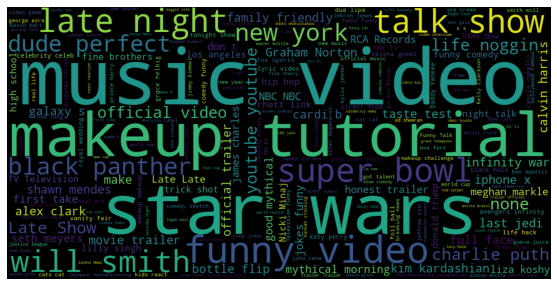

In [26]:
wordcloud = WordCloud(width = 1000, height = 500, stopwords = set(STOPWORDS)).generate(total_tags)
plt.figure(figsize=(10,5))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

## 3. Analysis on views, likes and dislikes

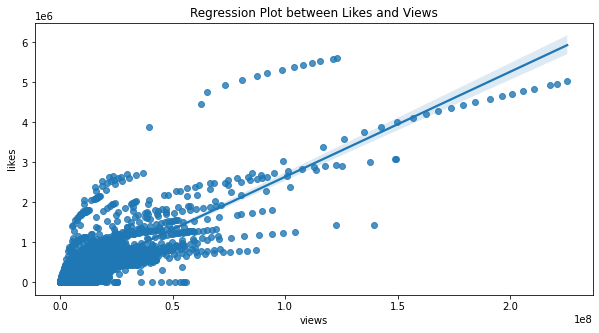

In [27]:
plt.figure(figsize=(10,5))
sns.regplot(data = us_videos, x = 'views', y = 'likes')
plt.title("Regression Plot between Likes and Views")
plt.show()

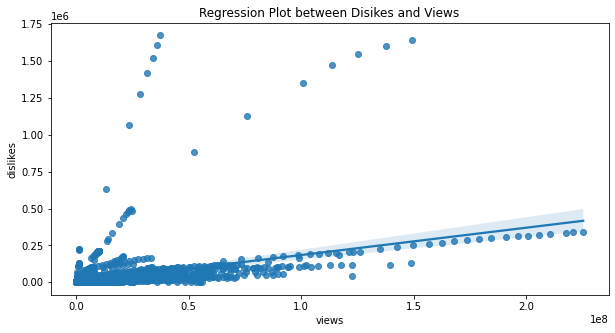

In [28]:
plt.figure(figsize=(10,5))
sns.regplot(data = us_videos, x = 'views', y = 'dislikes')
plt.title("Regression Plot between Disikes and Views")
plt.show()

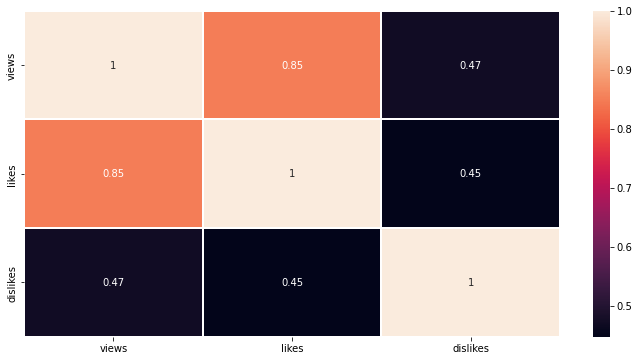

In [29]:
corr_df = us_videos[['views','likes','dislikes']]
plt.figure(figsize=(12,6))
sns.heatmap(corr_df.corr(),annot=True,linewidths=2)
plt.show()

**From the regression plot and heatmap we can understand that views and likes are highly correlated whereas the views and dislikes are not highly correlated**

## 4. Analysing Emojis in the comments

In [30]:
us_comments.head(5)

,video_id,comment_text,likes,replies,polarity
0,XpVt6Z1Gjjo,Logan Paul it's yo big day ‼️‼️‼️,4,0,0.0
1,XpVt6Z1Gjjo,I've been following you from the start of your...,3,0,0.0
2,XpVt6Z1Gjjo,Say hi to Kong and maverick for me,3,0,0.0
3,XpVt6Z1Gjjo,MY FAN . attendance,3,0,0.0
4,XpVt6Z1Gjjo,trending 😉,3,0,0.0


In [31]:
import emoji

In [32]:
us_comments['comment_text'].isna().sum()

25

In [33]:
us_comments.dropna(inplace=True)

In [34]:
us_comments['comment_text'].isna().sum()

0

In [35]:
# Every emoji has its unicode character in python. For example,
'\U0001F600'

'😀'

In [36]:
emojis = ''
for i in us_comments['comment_text']:
    lst = [c for c in i if emoji.is_emoji(c)]
    for ele in lst:
        emojis+=ele
# Checking whether the comment has any emoji and if so then it is taken in a string

In [37]:
len(emojis) # Checking the length of all the emojis

294549

In [38]:
len(set(emojis)) # Checking the lenght of all unique emojis

1098

In [39]:
emoji_dct = {i:emojis.count(i) for i in set(emojis)} 
# Finding the sum of occurence of all emojis and converting it into a dictionary

In [40]:
emoji_dct

{'🎥': 76,
 '🌼': 108,
 '💴': 40,
 '😔': 545,
 '🎊': 125,
 '🏿': 501,
 '🚃': 4,
 '🗜': 3,
 '🙉': 43,
 '👽': 162,
 '🐜': 48,
 '🍎': 49,
 '👸': 120,
 '🍜': 59,
 '🚰': 11,
 '🛍': 9,
 '🚴': 9,
 '🎨': 22,
 '🕒': 4,
 '◾': 4,
 '💄': 177,
 '😄': 1496,
 '📣': 40,
 '💧': 43,
 '🤨': 2,
 '🔄': 5,
 '👹': 49,
 '🈷': 4,
 '😹': 201,
 '💂': 15,
 '💣': 197,
 '🍃': 59,
 '😢': 2672,
 '🌫': 4,
 '🍝': 26,
 '🍰': 73,
 '🚾': 14,
 '‼': 211,
 '🐻': 128,
 '⏫': 4,
 '♿': 6,
 '🔁': 7,
 '🧢': 1,
 '👤': 8,
 '😧': 146,
 '🐲': 28,
 '😚': 482,
 '◀': 20,
 '🐋': 15,
 '♣': 12,
 '🦈': 10,
 '⤴': 7,
 '😁': 2220,
 '🚓': 7,
 '😳': 398,
 '🍱': 16,
 '🎳': 21,
 '🍼': 52,
 '💜': 3429,
 '👓': 21,
 '🌭': 19,
 '⚛': 3,
 '😝': 413,
 '🏨': 6,
 '💭': 43,
 '🍕': 258,
 '👍': 5476,
 '🤪': 1,
 '🛏': 7,
 '😗': 354,
 '🚡': 7,
 '🏒': 7,
 '🔙': 9,
 '🚶': 14,
 '🕕': 6,
 '🚹': 7,
 '🤑': 108,
 '👷': 15,
 '😰': 231,
 '🎅': 55,
 '🎆': 86,
 '🚘': 12,
 '🔚': 4,
 '⏯': 2,
 '🎍': 14,
 '🍐': 36,
 '⏺': 2,
 '🃏': 16,
 '😮': 1232,
 '💒': 14,
 '🆕': 7,
 '🐮': 13,
 '⏮': 3,
 '🧐': 3,
 '🕙': 4,
 '⌚': 19,
 '🍓': 252,
 '👆': 70,
 '🧀': 28,
 '🔼': 11,
 

In [41]:
# Sorting the dictionary
emoji_dct = {key:value for key,value in sorted(emoji_dct.items(),key = lambda item:item[1])}
emoji_dct

{'🧢': 1,
 '🤪': 1,
 '🤬': 1,
 '🤭': 1,
 '♾': 1,
 '🤟': 1,
 '🤨': 2,
 '⏯': 2,
 '⏺': 2,
 '⚙': 2,
 '🏷': 2,
 '🎏': 2,
 '⚒': 2,
 '🖲': 2,
 '🗄': 2,
 '⏹': 2,
 '⏭': 2,
 '🖨': 2,
 '⏸': 2,
 '☦': 2,
 '⚗': 2,
 '☣': 2,
 '🔟': 2,
 '🛢': 2,
 '🗜': 3,
 '⚛': 3,
 '⏮': 3,
 '🧐': 3,
 '⏲': 3,
 '☸': 3,
 '🗃': 3,
 '🗞': 3,
 '💹': 3,
 '🤺': 3,
 '⛰': 3,
 '🖇': 3,
 '☂': 3,
 '🗓': 3,
 '🛩': 3,
 '◼': 3,
 '🏎': 3,
 '🛶': 3,
 '🚏': 3,
 '🎎': 3,
 '🔖': 3,
 '➗': 3,
 '🕉': 3,
 '◻': 3,
 '🚕': 3,
 '🖌': 3,
 '🗂': 3,
 '🏑': 3,
 '🛣': 3,
 '🔳': 3,
 '🏮': 3,
 '📴': 3,
 '🕳': 3,
 '🗒': 3,
 '◽': 3,
 '🕹': 3,
 '🗳': 3,
 '🚃': 4,
 '🕒': 4,
 '◾': 4,
 '🈷': 4,
 '🌫': 4,
 '⏫': 4,
 '🔚': 4,
 '🕙': 4,
 '🚚': 4,
 '🆔': 4,
 '🖼': 4,
 '🕗': 4,
 '⛏': 4,
 '🕘': 4,
 '⛩': 4,
 '🉑': 4,
 '🕣': 4,
 '🔹': 4,
 '↖': 4,
 '🛳': 4,
 '❔': 4,
 '🛂': 4,
 '🚐': 4,
 '⏱': 4,
 '🛬': 4,
 '🏤': 4,
 '🕟': 4,
 '🛃': 4,
 '✡': 4,
 '🕜': 4,
 '🏖': 4,
 '🚉': 4,
 '🎚': 4,
 '🚎': 4,
 '🏧': 4,
 '🛤': 4,
 '🚜': 4,
 '⏪': 4,
 '🥅': 4,
 '🏘': 4,
 '↕': 4,
 '🕠': 4,
 '🆚': 4,
 '🚄': 4,
 '🚧': 4,
 '🆖': 4,
 '🥜': 4,
 '🎽': 4,
 '🈚': 4,
 '🎐': 4,
 

In [42]:
keys = [*emoji_dct.keys()]
# * represents everything

In [43]:
values = [*emoji_dct.values()]

In [44]:
len(keys)

1098

In [45]:
len(values)

1098

In [46]:
# Converting the dictionary into dataframe
total_emoji_df = pd.DataFrame({'Emojis':keys[-20:],'Frequency':values[-20:]})
total_emoji_df

,Emojis,Frequency
0,🤣,2279
1,🏼,2549
2,😢,2672
3,💙,2831
4,👌,3112
5,😬,3381
6,💜,3429
7,🏻,3438
8,😊,3596
9,♥,4909


##### Plot between top 20 Emojis and its frequencies:

In [48]:
import plotly.graph_objs as go
from plotly.offline import iplot

In [49]:
trace = go.Bar(x = total_emoji_df['Emojis'],y = total_emoji_df['Frequency'])
iplot([trace])